# For Image Description inference Hugging Face gave a code for using SmolVLM-Instruct, which should take instruction besides an image. 

In [4]:
from transformers import AutoProcessor, AutoModelForVision2Seq
import torch
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

processor = AutoProcessor.from_pretrained("HuggingFaceTB/SmolVLM-Instruct")
model = AutoModelForVision2Seq.from_pretrained("HuggingFaceTB/SmolVLM-Instruct",
                                                torch_dtype=torch.bfloat16,
                                                _attn_implementation="flash_attention_2" if DEVICE == "cuda" else "eager").to(DEVICE)


processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

C:\Users\marij\anaconda3\Lib\site-packages\huggingface_hub\file_download.py:144: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\marij\.cache\huggingface\hub\models--HuggingFaceTB--SmolVLM-Instruct. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


chat_template.json:   0%|          | 0.00/429 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/486 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/4.48k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/801k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/466k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/3.52M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/92.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/1.07k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/7.45k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/4.49G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/136 [00:00<?, ?B/s]

In [10]:
from PIL import Image
from transformers.image_utils import load_image


# Load images
image1 = load_image("https://huggingface.co/spaces/HuggingFaceTB/SmolVLM/resolve/main/example_images/rococo.jpg")
image2 = load_image("https://huggingface.co/spaces/HuggingFaceTB/SmolVLM/resolve/main/example_images/rococo_1.jpg")

# Create input messages
messages = [
    {
        "role": "user",
        "content": [
            {"type": "image"},
            {"type": "image"},
            {"type": "text", "text": "Can you describe the two images?"}
        ]
    },
]

# Prepare inputs
prompt = processor.apply_chat_template(messages, add_generation_prompt=True)
inputs = processor(text=prompt, images=[image1, image2], return_tensors="pt")
inputs = inputs.to(DEVICE)


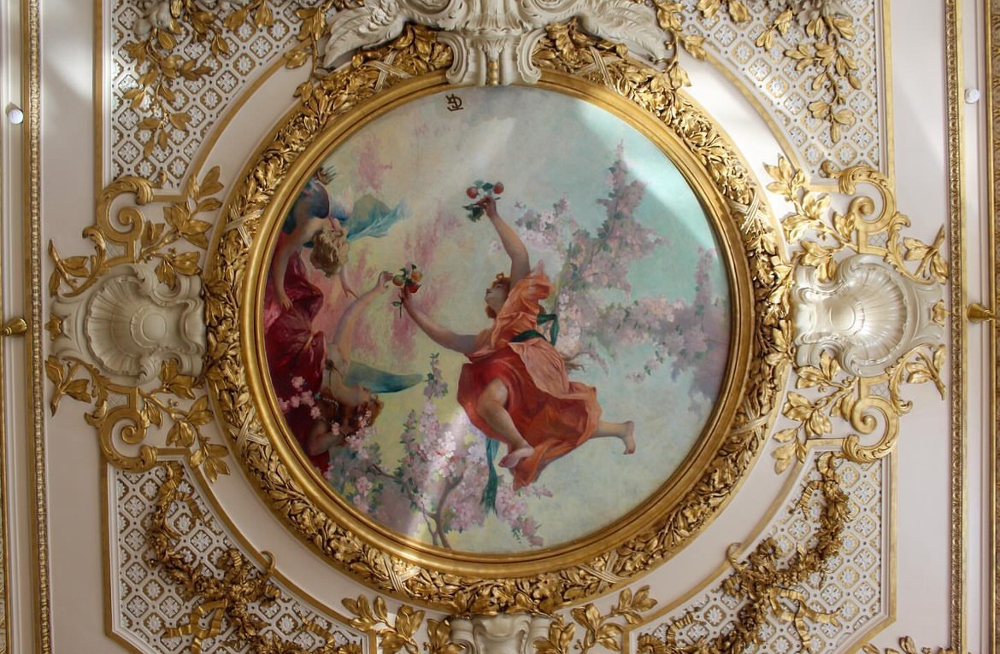

In [14]:
image1


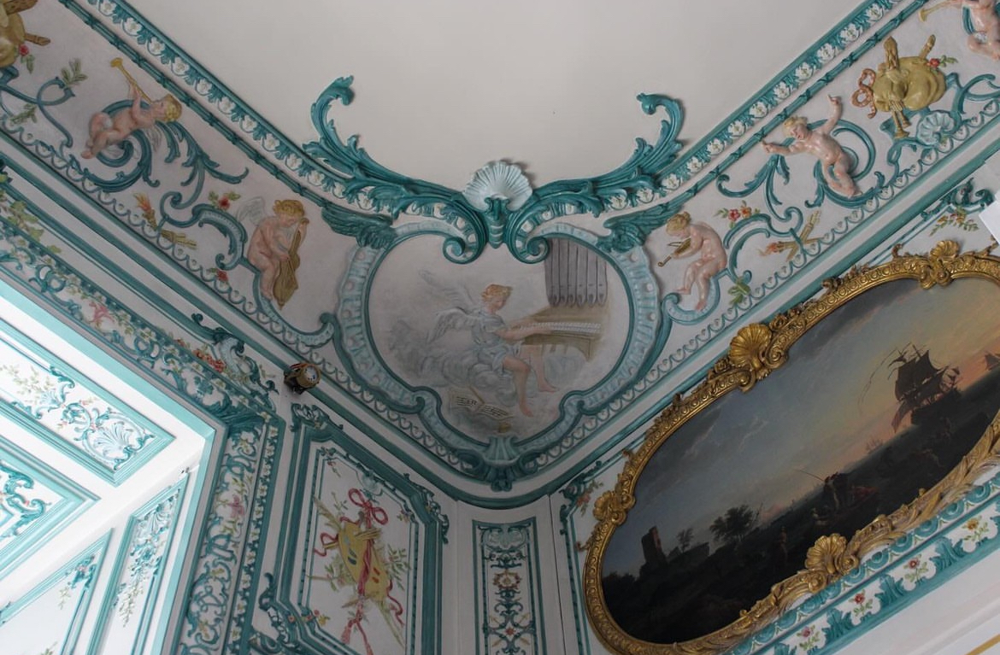

In [16]:
image2

In [12]:
# Generate outputs
generated_ids = model.generate(**inputs, max_new_tokens=500) #these are output ids of tokens from the models vocabulary!
generated_texts = processor.batch_decode(
    generated_ids,
    skip_special_tokens=True,
)

print(generated_texts[0])


User:<image>Can you describe the two images?
Assistant: The first image is a painting of two cherubs holding flowers, while the second image is a painting of a ship sailing on the sea.


# My images

In [30]:
from PIL import Image
image1 = Image.open("Images\\133901516337172330.jpg").convert("RGB")
image2 = Image.open("Images\\Screenshot 2025-04-21 213329.png").convert("RGB")

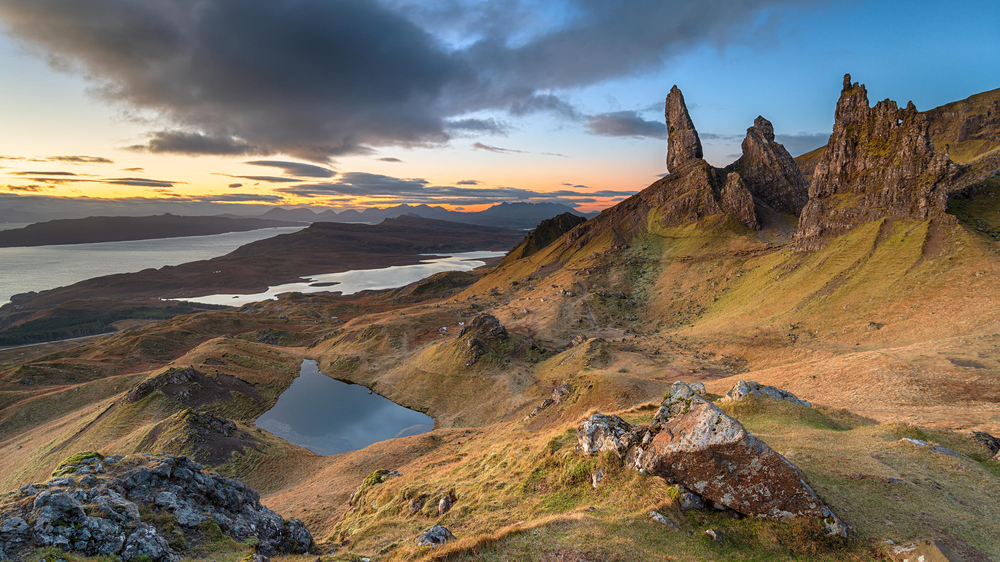

In [32]:
image1

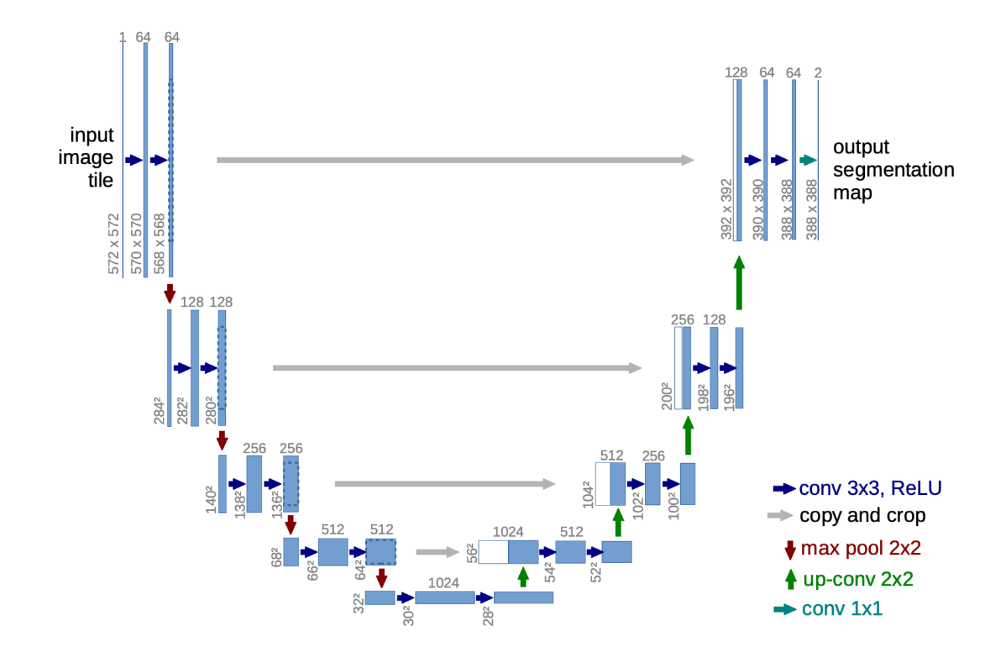

In [34]:
image2

In [38]:
messages = [
    {
        "role": "user",
        "content": [
            {"type": "image"},
            {"type": "image"},
            {"type": "text", "text": "Can you describe the two images?"}
        ]
    },
]

# Prepare inputs
prompt = processor.apply_chat_template(messages, add_generation_prompt=True)
inputs = processor(text=prompt, images=[image1, image2], return_tensors="pt")
inputs = inputs.to(DEVICE)
generated_ids = model.generate(**inputs, max_new_tokens=500) #these are output ids of tokens from the models vocabulary!
generated_texts = processor.batch_decode(
    generated_ids,
    skip_special_tokens=True,
)

print(generated_texts[0])

User:<image>Can you describe the two images?
Assistant: Image 1 shows a landscape with a large body of water, mountains, and a rocky terrain. Image 2 shows a close-up of a rocky terrain with a small body of water.


# Another pair of my images

In [41]:
image1 = Image.open("Images\\Screenshot 2025-04-21 150029.png").convert("RGB")
image2 = Image.open("Images\\Screenshot 2025-04-21 213329.png").convert("RGB")

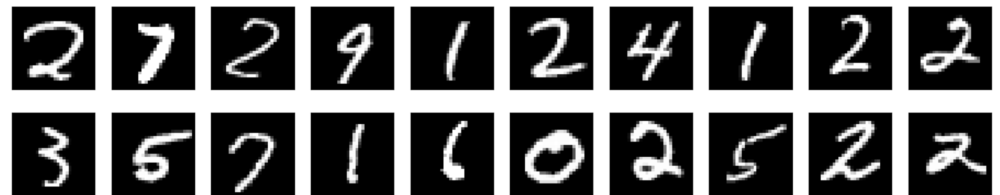

In [45]:
image1

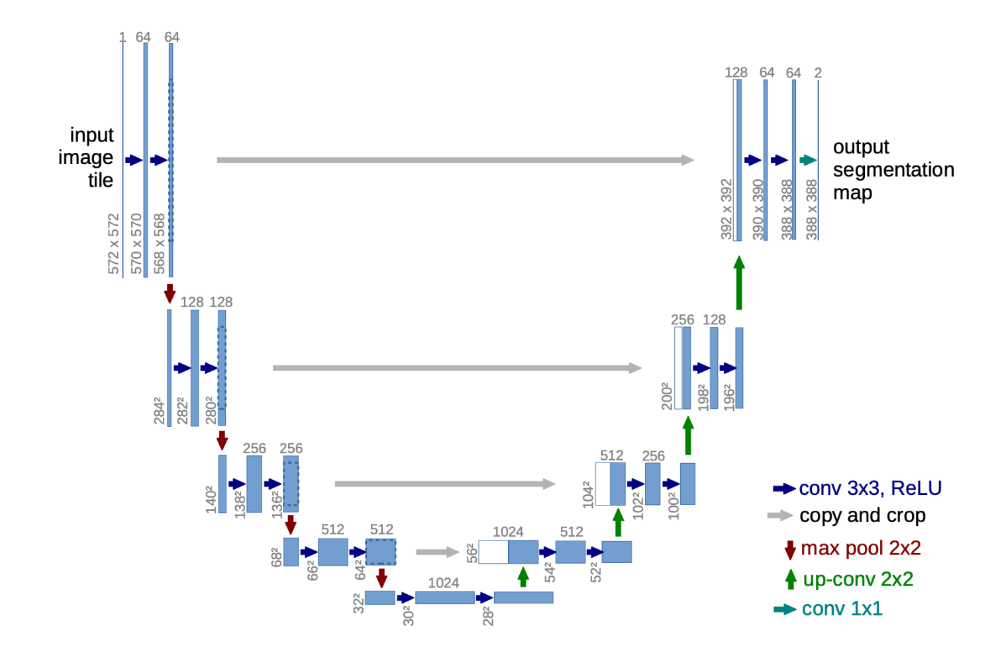

In [48]:
image2

In [52]:
messages = [
    {
        "role": "user",
        "content": [
            {"type": "image"},
            {"type": "image"},
            {"type": "text", "text": "Can you describe the two images?"}
        ]
    },
]

# Prepare inputs
prompt = processor.apply_chat_template(messages, add_generation_prompt=True)
inputs = processor(text=prompt, images=[image1, image2], return_tensors="pt")
inputs = inputs.to(DEVICE)
generated_ids = model.generate(**inputs, max_new_tokens=500) #these are output ids of tokens from the models vocabulary!
generated_texts = processor.batch_decode(
    generated_ids,
    skip_special_tokens=True,
)

print(generated_texts[0])

User:<image>Can you describe the two images?
Assistant: Image 1 is a tile image, and Image 2 is a segmentation map.


In [58]:
messages = [
    {
        "role": "user",
        "content": [
            {"type": "image"},
            {"type": "text", "text": "Can you describe the two images?"}
        ]
    },
]
prompt = processor.apply_chat_template(messages, add_generation_prompt=True)
inputs = processor(text=prompt, images=[image1], return_tensors="pt")
inputs = inputs.to(DEVICE)
generated_ids = model.generate(**inputs, max_new_tokens=500) #these are output ids of tokens from the models vocabulary!
generated_texts = processor.batch_decode(
    generated_ids,
    skip_special_tokens=True,
)

print(generated_texts[0])

User:<image>Can you describe the two images?
Assistant: The first image is a set of numbers from 2 to 9. The numbers are written in a white font on a black background. The second image is also a set of numbers from 2 to 9. The numbers are written in a white font on a black background.


In [60]:
messages = [
    {
        "role": "user",
        "content": [
            {"type": "image"},
            {"type": "text", "text": "Can you describe the two images?"}
        ]
    },
]
prompt = processor.apply_chat_template(messages, add_generation_prompt=True)
inputs = processor(text=prompt, images=[image2], return_tensors="pt")
inputs = inputs.to(DEVICE)
generated_ids = model.generate(**inputs, max_new_tokens=500) #these are output ids of tokens from the models vocabulary!
generated_texts = processor.batch_decode(
    generated_ids,
    skip_special_tokens=True,
)

print(generated_texts[0])

User:<image>Can you describe the two images?
Assistant: Image 1 is labeled "input image" and Image 2 is labeled "tile".
